# Spaceborne-Ground Radar Calibration (Application) 

In this tutorial, we demonstrate how to exploit GPM-API along with other radar software such
[xradar](https://docs.openradarscience.org/projects/xradar/en/stable/) and 
[wradlib](https://docs.wradlib.org/en/latest/) to match reflectivities measurements of spaceborne (SR) and ground (GR) radars and assess the GR calibration bias.

As example, we analyze a coincident GPM DPR and NEXRAD overpass over San Diego, USA, during the landfall of Tropical Storm Hilary in 2023. The NEXRAD KNKX radar data appears to be significantly miscalibrated and we will assess the calibration bias.

To facilitate your hands-on experience, we've preprocessed the native NEXRAD radar data using the xradar package and the coincident GPM DPR overpass using GPM-API. The resulting data has been uploaded in Zarr format to the Pythia Cloud Bucket, allowing you to start the tutorial directly in the Binder environment.

If you wish to adapt this tutorial to your own case study, you can use the xradar package to read your GR radar data into the expected xarray format. Similarly, you can retrieve the relevant GPM data using GPM-API.

Additionally, note that the GPM-API's `volume_matching` routine can automatically download and open the coincident GPM overpass data if the SR dataset is not provided to the function.

Please read the [Spaceborne-Ground Radar Matching Tutorial](
https://gpm-api.readthedocs.io/en/latest/tutorials/tutorial_03_SR_GR_Matching.html) for a step-by-step guide through the process of obtaining spatially and temporally coincident radar samples.

Now let's start the tutorial by importing the required packages:

In [1]:
import warnings

warnings.filterwarnings("ignore")

from functools import reduce

import cartopy.crs as ccrs
import fsspec
import numpy as np
import xradar as xd
import xarray as xr
from IPython.display import display
from xarray.backends.api import open_datatree
from gpm.gv import (
    calibration_summary,
    compare_maps,
    reflectivity_scatterplots,
    volume_matching,
)

np.set_printoptions(suppress=True)

## Load SR and GR data 

Now let's open the NEXRAD GR data and the GPM granule with the coincident overpass.

In [2]:
# Open fsspec connection to the bucket
bucket_url = "https://js2.jetstream-cloud.org:8001"
fs = fsspec.filesystem("s3", anon=True, client_kwargs=dict(endpoint_url=bucket_url))

In [3]:
# Open the GR datatree
file = fs.get_mapper(f"pythia/radar/erad2024/gpm_api/KNKX20230820_221341_V06.zarr")
dt_gr = open_datatree(file, engine="zarr", consolidated=True, chunks={})
display(dt_gr)

<xarray.DataTree>
Group: /
│   Dimensions:              ()
│   Data variables:
│       altitude             int64 8B ...
│       instrument_type      <U5 20B ...
│       latitude             float64 8B ...
│       longitude            float64 8B ...
│       platform_type        <U5 20B ...
│       time_coverage_end    <U20 80B ...
│       time_coverage_start  <U20 80B ...
│       volume_number        int64 8B ...
│   Attributes:
│       Conventions:      None
│       comment:          im/exported using xradar
│       history:          None
│       institution:      None
│       instrument_name:  KNKX
│       references:       None
│       source:           None
│       title:            None
│       version:          None
├── Group: /sweep_0
│       Dimensions:            (azimuth: 720, range: 1832)
│       Coordinates:
│           altitude           int64 8B ...
│         * azimuth            (azimuth) float64 6kB 0.2499 0.7471 1.261 ... 359.2 359.8
│           elevation          (azimuth) float64 6kB dask.array<chunksize=(720,), meta=np.ndarray>
│           latitude           float64 8B ...
│           longitude          float64 8B ...
│         * range              (range) float32 7kB 2.125e+03 2.375e+03 ... 4.599e+05
│           time               (azimuth) datetime64[ns] 6kB dask.array<chunksize=(720,), meta=np.ndarray>
│       Data variables:
│           CCORH              (azimuth, range) float64 11MB dask.array<chunksize=(360, 916), meta=np.ndarray>
│           DBZH               (azimuth, range) float64 11MB dask.array<chunksize=(360, 916), meta=np.ndarray>
│           PHIDP              (azimuth, range) float64 11MB dask.array<chunksize=(180, 916), meta=np.ndarray>
│           RHOHV              (azimuth, range) float64 11MB dask.array<chunksize=(360, 916), meta=np.ndarray>
│           ZDR                (azimuth, range) float64 11MB dask.array<chunksize=(360, 916), meta=np.ndarray>
│           follow_mode        <U7 28B ...
│           prt_mode           <U7 28B ...
│           sweep_fixed_angle  float64 8B ...
│           sweep_mode         <U20 80B ...
│           sweep_number       int64 8B ...
│       Attributes:
│           instrument_name:  KNKX
├── Group: /sweep_1
│       Dimensions:            (azimuth: 720, range: 1192)
│       Coordinates:
│           altitude           int64 8B ...
│         * azimuth            (azimuth) float64 6kB 0.217 0.7086 1.189 ... 359.2 359.7
│           elevation          (azimuth) float64 6kB dask.array<chunksize=(720,), meta=np.ndarray>
│           latitude           float64 8B ...
│           longitude          float64 8B ...
│         * range              (range) float32 5kB 2.125e+03 2.375e+03 ... 2.999e+05
│           time               (azimuth) datetime64[ns] 6kB dask.array<chunksize=(720,), meta=np.ndarray>
│       Data variables:
│           DBZH               (azimuth, range) float64 7MB dask.array<chunksize=(360, 596), meta=np.ndarray>
│           VRADH              (azimuth, range) float64 7MB dask.array<chunksize=(360, 596), meta=np.ndarray>
│           WRADH              (azimuth, range) float64 7MB dask.array<chunksize=(360, 596), meta=np.ndarray>
│           follow_mode        <U7 28B ...
│           prt_mode           <U7 28B ...
│           sweep_fixed_angle  float64 8B ...
│           sweep_mode         <U20 80B ...
│           sweep_number       int64 8B ...
│       Attributes:
│           instrument_name:  KNKX
├── Group: /sweep_10
│       Dimensions:            (azimuth: 360, range: 1336)
│       Coordinates:
│           altitude           int64 8B ...
│         * azimuth            (azimuth) float64 3kB 0.5823 1.571 2.59 ... 358.6 359.6
│           elevation          (azimuth) float64 3kB dask.array<chunksize=(360,), meta=np.ndarray>
│           latitude           float64 8B ...
│           longitude          float64 8B ...
│         * range              (range) float32 5kB 2.125e+03 2.375e+03 ... 3.359e+05
│           time               (azimuth) datetim

In [4]:
# Open the SR dataset
file = fs.get_mapper(
    f"pythia/radar/erad2024/gpm_api/2A.GPM.DPR.V9-20211125.20230820-S213941-E231213.053847.V07B.zarr"
)
ds_sr = xr.open_zarr(file, consolidated=True, chunks={})

Now, let's select a GR sweep to match with GPM DPR:

In [5]:
print("Available sweeps:", list(dt_gr.groups))

Available sweeps: ['/', '/sweep_0', '/sweep_1', '/sweep_10', '/sweep_11', '/sweep_12', '/sweep_13', '/sweep_14', '/sweep_15', '/sweep_16', '/sweep_17', '/sweep_18', '/sweep_19', '/sweep_2', '/sweep_3', '/sweep_4', '/sweep_5', '/sweep_6', '/sweep_7', '/sweep_8', '/sweep_9']


In [6]:
sweep_idx = 0
sweep_group = f"sweep_{sweep_idx}"  # GR sweep (elevation to be used)
ds_gr = dt_gr[sweep_group].to_dataset().compute()

and display the horizontally and vertically polarized reflectivity fields:

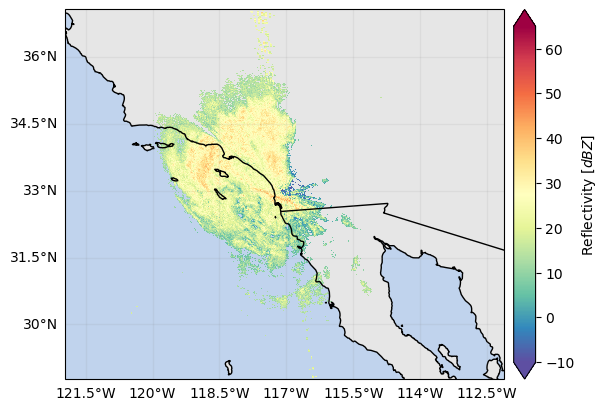

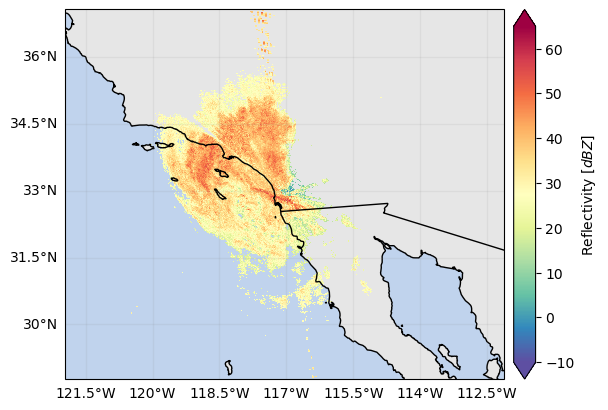

In [7]:
ds_gr["DBZH"].where(ds_gr["DBZH"] > -10).xradar_dev.plot_map()
ds_gr["DBZV"] = (ds_gr["DBZH"].gpm.idecibel / ds_gr["ZDR"].gpm.idecibel).gpm.decibel
ds_gr["DBZV"].where(ds_gr["DBZV"] > -10).xradar_dev.plot_map()
# ds_gr["ZDR"].xradar_dev.plot_map()

## Run SR/GR volume matching


Here we start defining the required settings for the SR/GR volume matching procedure: 

- The GR `radar_band` controls to which frequency SR Ku-band reflectivities will be converted. Valid values are `X`, `C`, `S`, `Ku`.
- The `beamwidth_gr` refers to the angular beam width of the GR.
- The minimum reflectivity thresholds `z_min_threshold_sr` and `z_min_threshold_gr` are used to mask out SR and GR
gates belows such thresholds.

In [8]:
radar_band = "S"
beamwidth_gr = 1
z_min_threshold_gr = 0
z_min_threshold_sr = 10

The SR/GR volume matching routine typically takes around 40-50 seconds to complete. It returns a `geopandas.DataFrame` with the matched aggregated reflectivities and the associated statistics.

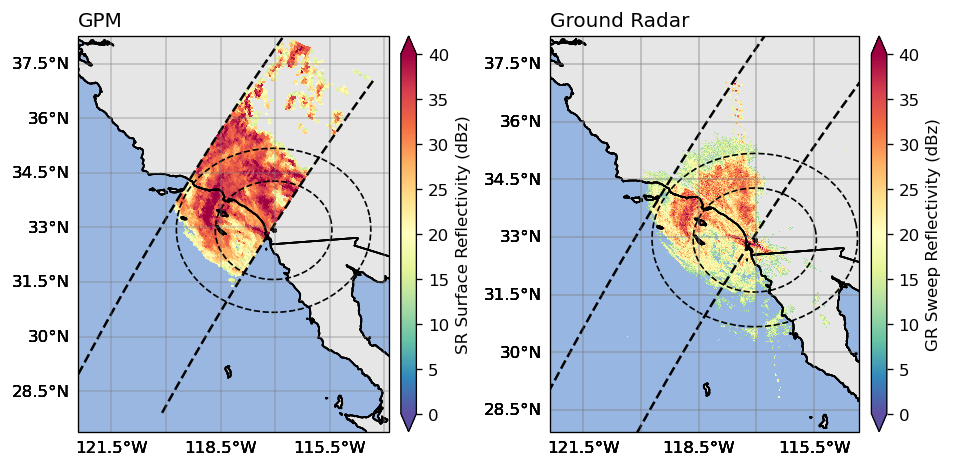

SR/GR Matching Elapsed time: 0:00:18.971681 .


In [9]:
gdf_match = volume_matching(
    ds_gr=ds_gr,
    ds_sr=ds_sr,
    z_variable_gr="DBZH",
    radar_band=radar_band,
    beamwidth_gr=beamwidth_gr,
    z_min_threshold_gr=z_min_threshold_gr,
    z_min_threshold_sr=z_min_threshold_sr,
    min_gr_range=0,
    max_gr_range=150_000,
    # gr_sensitivity_thresholds=None,
    # sr_sensitivity_thresholds=None,
    download_sr=False,  # require internet connection !
    display_quicklook=True,
)
# Note: The circle radius in the quicklook represents the min_gr_range, max_gr_range and 250_000 m range distances.

In [10]:
display(gdf_match)

,GR_Z_mean,GR_Z_std,GR_Z_max,GR_Z_min,GR_Z_range,GR_Z_cov,GR_time,GR_gate_volume_sum,GR_fraction_covered_area,GR_counts,...,sweep_number,along_track,cross_track,VolumeRatio,VolumeDiff,time_difference,GR_z_lower_bound,GR_z_upper_bound,SR_z_lower_bound,SR_z_upper_bound
0,15.221830,12.594024,19.5,10.5,9.0,0.827366,2023-08-20 22:13:43.619000064,1.325220e+09,0.523921,50.0,...,0,98,42,44.668064,5.786978e+10,97,1535.796701,4204.951593,1654.094116,4209.583984
1,13.581805,10.557827,18.5,10.0,8.5,0.777351,2023-08-20 22:13:43.513999872,1.316104e+09,0.792108,73.0,...,0,98,43,47.688195,6.144654e+10,97,1514.601481,4200.459785,1558.925415,4227.430664
2,16.550807,15.714381,23.0,10.0,13.0,0.949463,2023-08-20 22:13:43.414000128,1.304555e+09,0.966467,92.0,...,0,98,44,46.511517,5.937226e+10,97,1494.739411,4194.752350,1605.041138,4143.421875
3,19.808129,18.675347,26.0,11.0,15.0,0.942812,2023-08-20 22:13:43.315000064,1.292233e+09,1.000000,98.0,...,0,98,45,47.599161,6.021699e+10,97,1475.392380,4182.133888,1527.083740,4056.250488
4,18.983302,18.326115,24.5,10.0,14.5,0.965381,2023-08-20 22:13:43.212000000,1.280453e+09,1.000000,98.0,...,0,98,46,48.697237,6.107406e+10,97,1468.574285,4156.773245,1571.319336,4090.862549
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1300,NaN,NaN,NaN,NaN,NaN,NaN,2023-08-20 22:13:51.476000000,NaN,0.994502,96.0,...,0,157,45,NaN,NaN,64,NaN,NaN,1537.145386,4186.728516
1301,NaN,NaN,NaN,NaN,NaN,NaN,2023-08-20 22:13:51.652999936,NaN,1.000000,99.0,...,0,157,46,NaN,NaN,64,NaN,NaN,1580.786865,4100.309082
1302,NaN,NaN,NaN,NaN,NaN,NaN,2023-08-20 22:13:51.756000000,NaN,1.000000,99.0,...,0,157,47,NaN,NaN,64,NaN,NaN,1527.273315,4036.591797
1303,NaN,NaN,NaN,NaN,NaN,NaN,2023-08-20 22:13:51.886000128,NaN,1.000000,104.0,...,0,157,48,NaN,NaN,64,NaN,NaN,1469.200317,4086.919434


## Analyse SR/GR database

Now let's first define the variables names of the SR and GR reflectivities:

In [11]:
sr_z_column = f"SR_zFactorFinal_{radar_band}_mean"
gr_z_column = "GR_Z_mean"

### Compare spatial reflectivity fields

Here we start comparing the spatial reflectivity fields without applying restrictive filtering criteria:

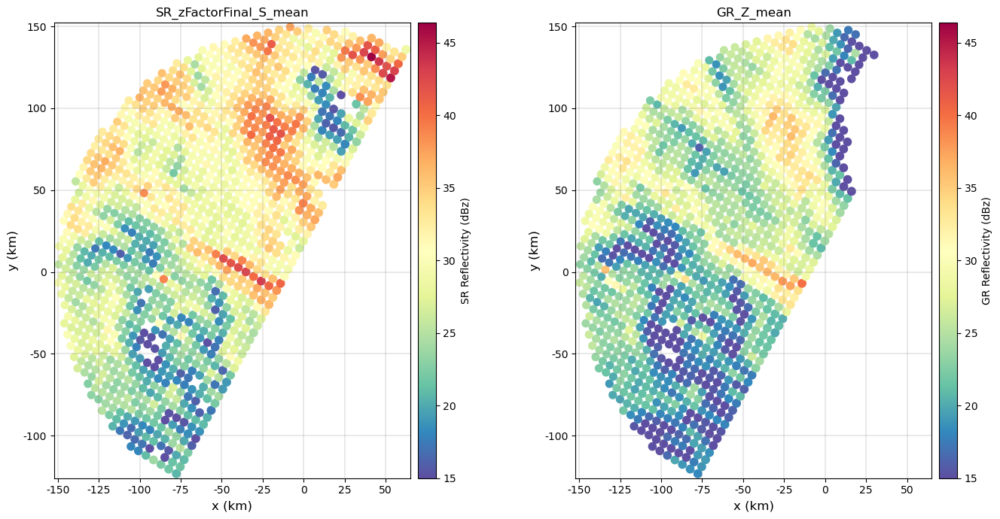

In [12]:
fig = compare_maps(
    gdf_match,
    sr_column=sr_z_column,
    gr_column=gr_z_column,
    sr_label="SR Reflectivity (dBz)",
    gr_label="GR Reflectivity (dBz)",
    cmap="Spectral_r",
    unified_color_scale=True,
    vmin=15,
    # vmax=40
)
fig.tight_layout()

If you wish to create a cartopy map, specify the `'projection'` in the `subplot_kwargs` argument:

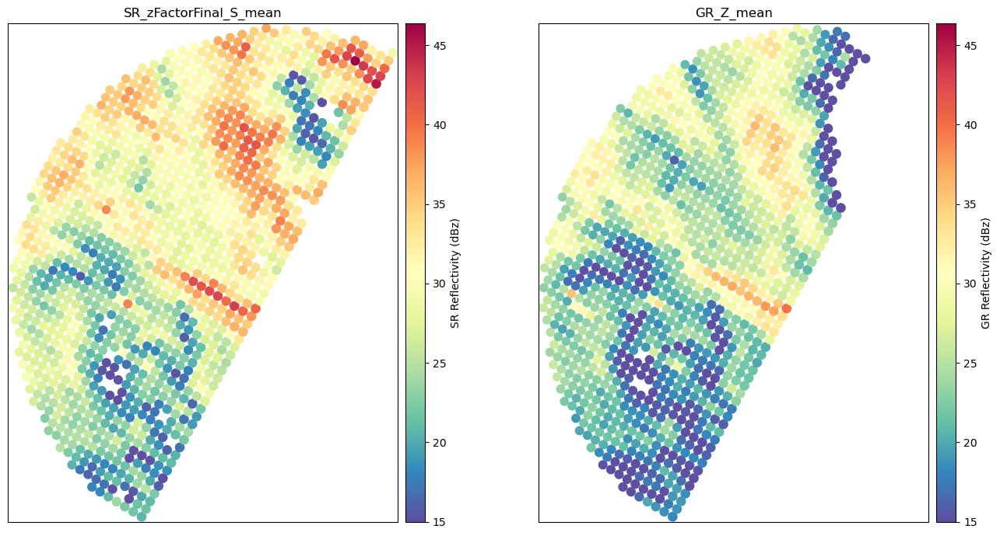

In [13]:
ccrs_gr_aeqd = ccrs.AzimuthalEquidistant(
    central_longitude=ds_gr["longitude"].item(),
    central_latitude=ds_gr["latitude"].item(),
)
subplot_kwargs = {}
subplot_kwargs["projection"] = ccrs_gr_aeqd
fig = compare_maps(
    gdf_match,
    sr_column=sr_z_column,
    gr_column=gr_z_column,
    sr_label="SR Reflectivity (dBz)",
    gr_label="GR Reflectivity (dBz)",
    cmap="Spectral_r",
    unified_color_scale=True,
    vmin=15,
    # vmax=40
    subplot_kwargs=subplot_kwargs,
)
fig.tight_layout()

Here we show how to explore interactively the reflectivity fields using [Folium](https://python-visualization.github.io/folium/latest/):

In [14]:
gdf_match.explore(column="GR_Z_mean", legend=True, cmap="Spectral_r", vmin=0, vmax=40)

### Generate calibration summary

We now create a figure comparing SR/GR aggregated reflectivities volume-by-volume and displaying the overall distributions.

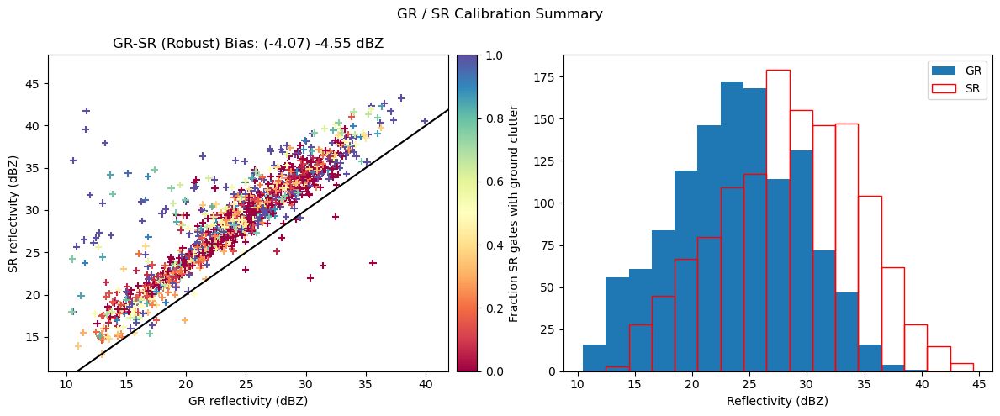

In [15]:
gr_z_column = "GR_Z_mean"
sr_z_column = f"SR_zFactorFinal_{radar_band}_mean"

fig = calibration_summary(
    df=gdf_match,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    # Histogram options
    bin_width=2,
    # Scatterplot options
    hue_column="SR_fraction_clutter",
    # gr_range=[15, 50]
    # sr_range=[15, 50]
    marker="+",
    cmap="Spectral",
)
fig.tight_layout()

### Investigate filtering criteria 

When comparing SR and GR data or trying to determine an accurate GR calibration bias, it's necessary to define a set of filtering criteria. In the figures below, we perform exploratory data analysis to investigate the relationships between the SR/GR reflectivity deviations and sets of variables characterizing radar measurements and SR/GR volume properties. The patterns and deviations observed in the scatterplots will be used to define a set of filtering critera in the next section of the tutorial.

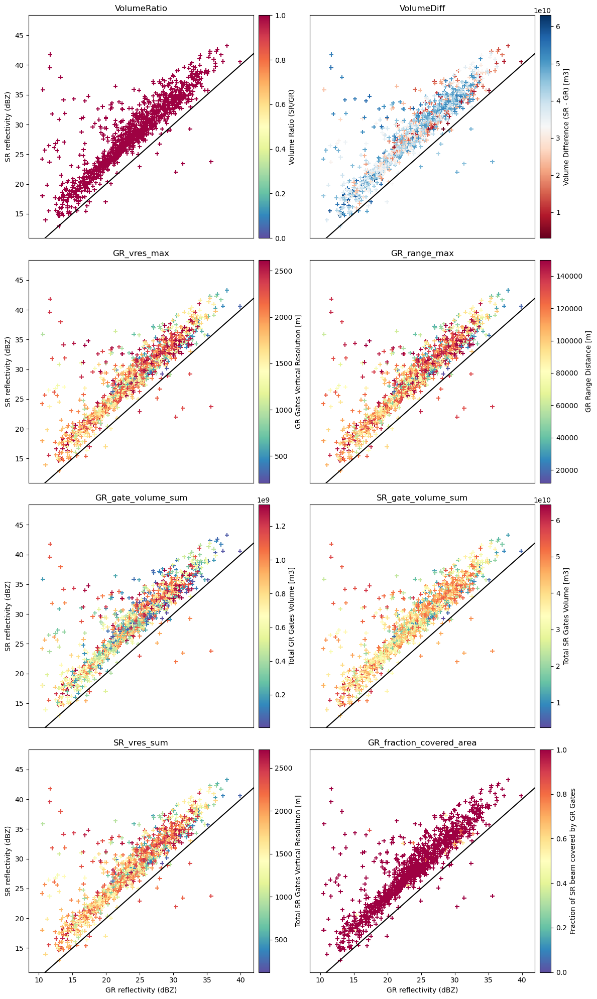

In [16]:
# Matching characteristics
hue_columns = [
    "VolumeRatio",
    "VolumeDiff",
    "GR_vres_max",
    "GR_range_max",
    "GR_gate_volume_sum",
    "SR_gate_volume_sum",
    "SR_vres_sum",
    "GR_fraction_covered_area",
]
fig = reflectivity_scatterplots(
    df=gdf_match,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    hue_columns=hue_columns,
    ncols=2,
)
fig.tight_layout()

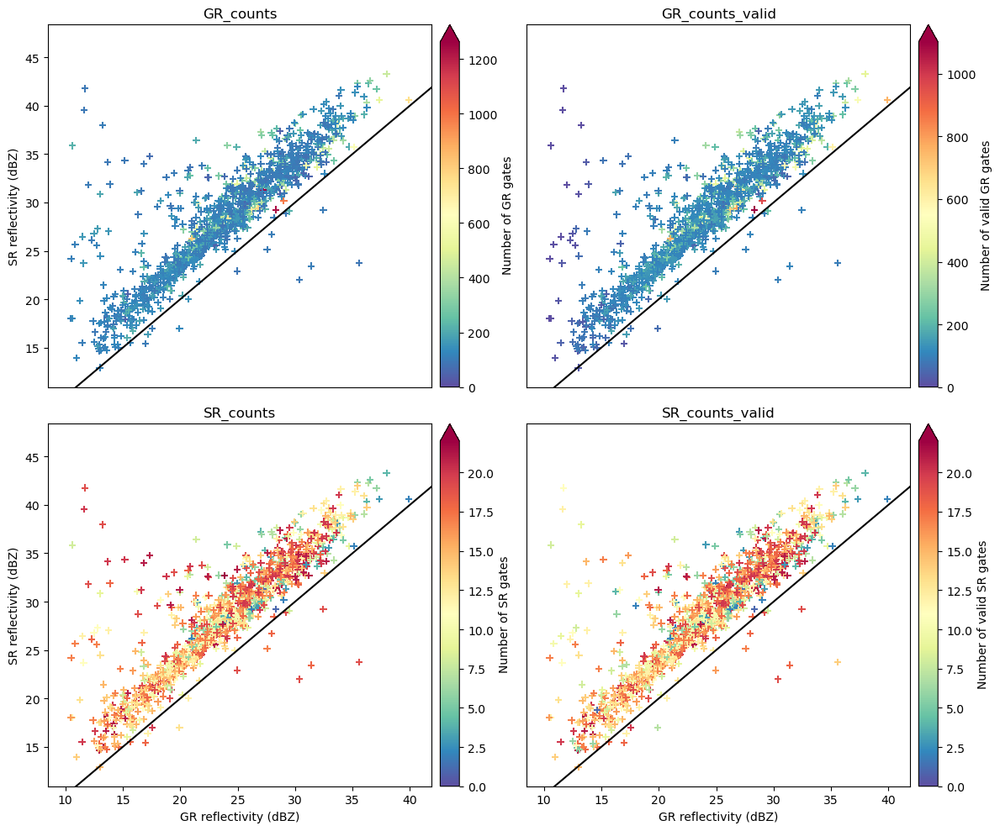

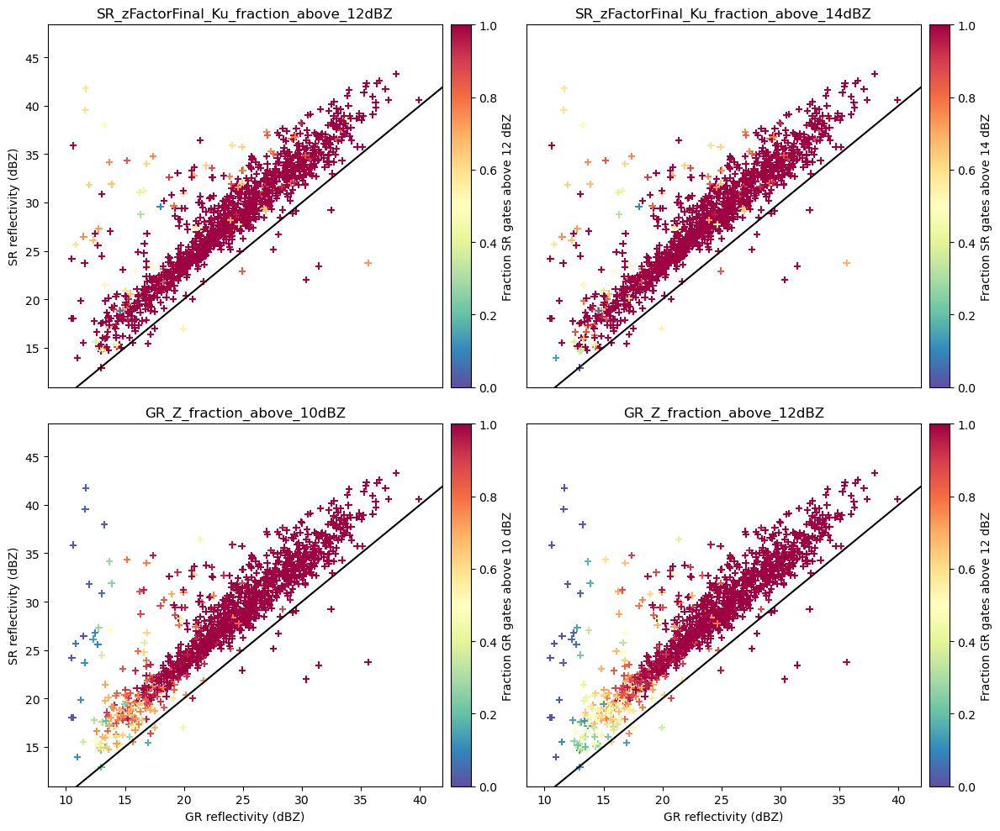

In [17]:
# Value validity & sensitivity
hue_columns = [
    "GR_counts",
    "GR_counts_valid",
    "SR_counts",
    "SR_counts_valid",
]
fig = reflectivity_scatterplots(
    df=gdf_match,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    hue_columns=hue_columns,
    ncols=2,
)
fig.tight_layout()

hue_columns = [
    "SR_zFactorFinal_Ku_fraction_above_12dBZ",
    "SR_zFactorFinal_Ku_fraction_above_14dBZ",
    "GR_Z_fraction_above_10dBZ",
    "GR_Z_fraction_above_12dBZ",
]
fig = reflectivity_scatterplots(
    df=gdf_match,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    hue_columns=hue_columns,
    ncols=2,
)
fig.tight_layout()

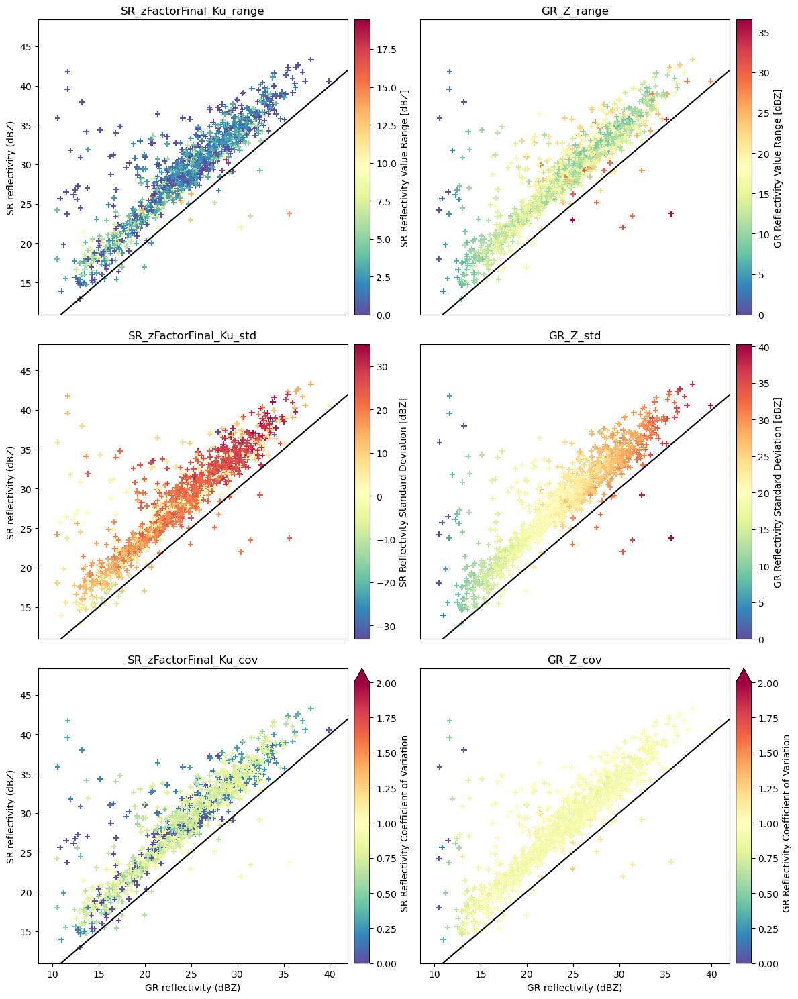

In [18]:
# NUBF & Variability
hue_columns = [
    "SR_zFactorFinal_Ku_range",
    "GR_Z_range",
    "SR_zFactorFinal_Ku_std",
    "GR_Z_std",
    "SR_zFactorFinal_Ku_cov",
    "GR_Z_cov",
]
fig = reflectivity_scatterplots(
    df=gdf_match,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    hue_columns=hue_columns,
    ncols=2,
)
fig.tight_layout()

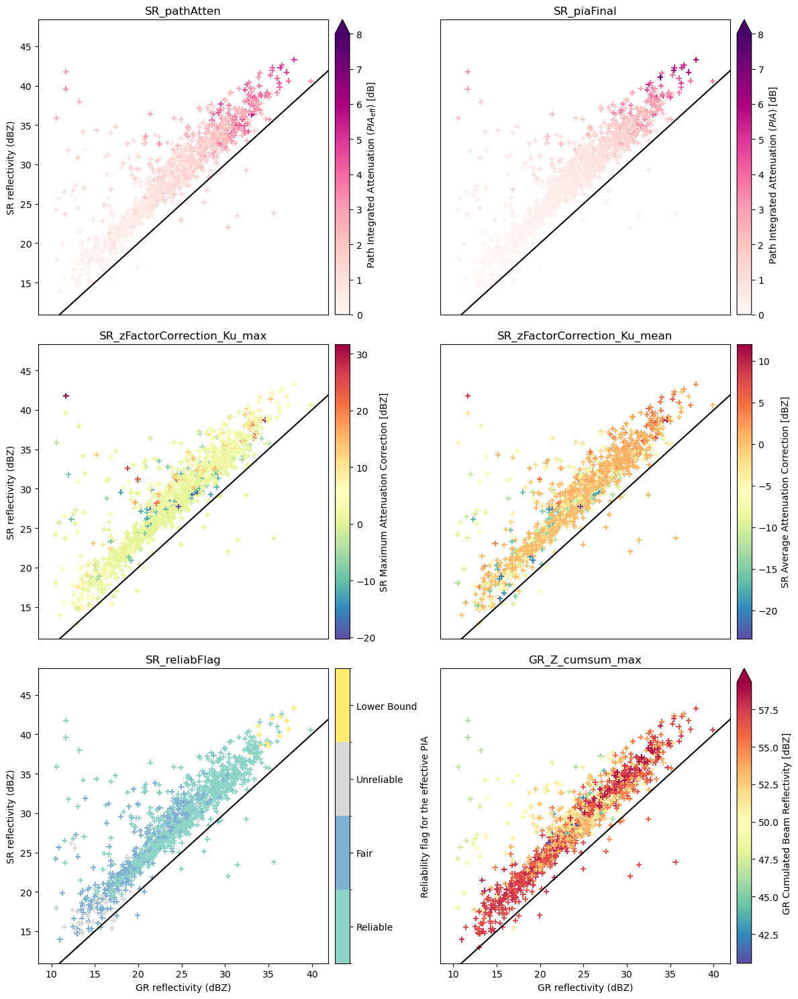

In [19]:
# Attenuation
hue_columns = [
    "SR_pathAtten",
    "SR_piaFinal",
    "SR_zFactorCorrection_Ku_max",
    "SR_zFactorCorrection_Ku_mean",
    "SR_reliabFlag",
    "GR_Z_cumsum_max",
]
fig = reflectivity_scatterplots(
    df=gdf_match,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    hue_columns=hue_columns,
    ncols=2,
)
fig.tight_layout()

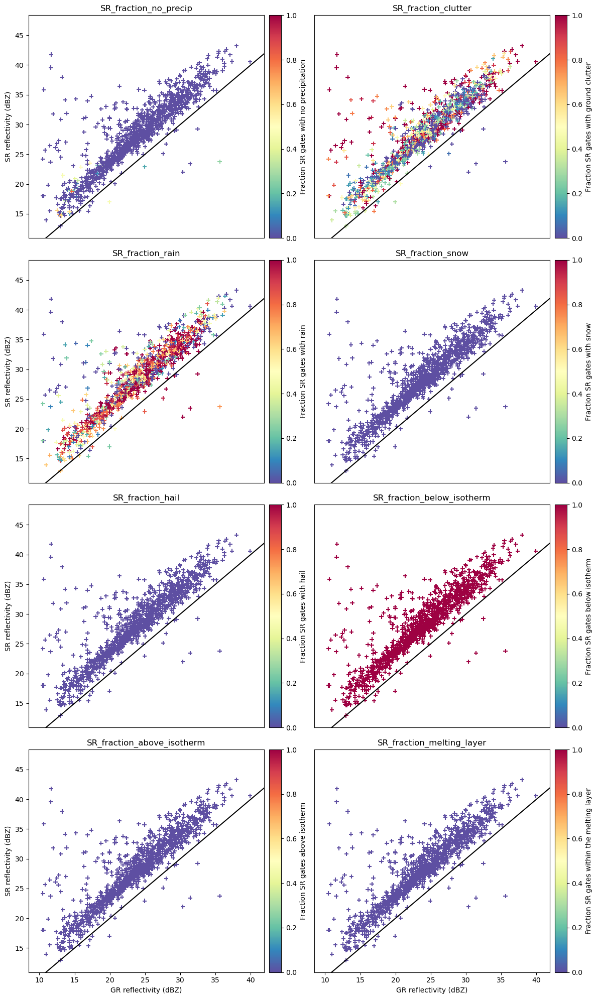

In [20]:
# Hydrometeors
hue_columns = [
    "SR_fraction_no_precip",
    "SR_fraction_clutter",
    "SR_fraction_rain",
    "SR_fraction_snow",
    "SR_fraction_hail",
    "SR_fraction_below_isotherm",
    "SR_fraction_above_isotherm",
    "SR_fraction_melting_layer",
    # 'SR_airTemperature_min',
]
fig = reflectivity_scatterplots(
    df=gdf_match,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    hue_columns=hue_columns,
    ncols=2,
)
fig.tight_layout()

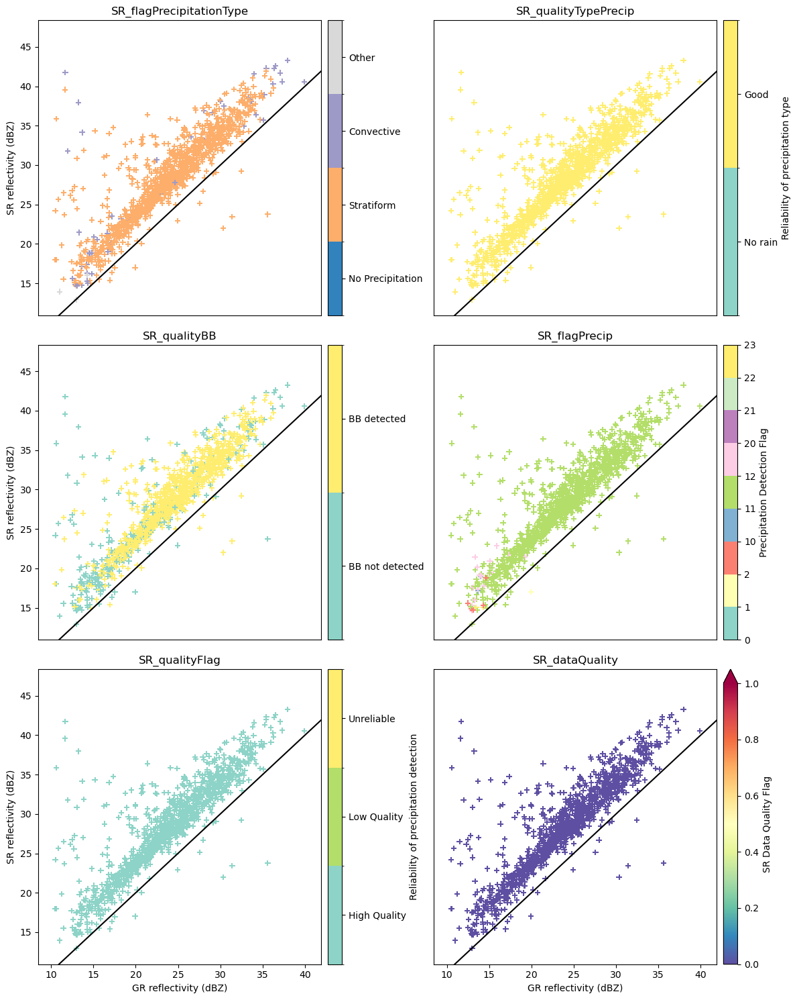

In [21]:
# SR Quality Flags
hue_columns = [
    "SR_flagPrecipitationType",
    "SR_qualityTypePrecip",
    "SR_qualityBB",
    "SR_flagPrecip",
    "SR_qualityFlag",
    "SR_dataQuality",
]
fig = reflectivity_scatterplots(
    df=gdf_match,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    hue_columns=hue_columns,
    ncols=2,
)
fig.tight_layout()

## Define SR/GR filtering criteria 

When calibrating or comparing SR and GR data, there is a necessary tradeoff between the strictness of filtering criteria filtering and the number of available samples. Here below we provide some general recommendations for effective filtering:

1. **Sensitivity Thresholds**: Retain only those radar beams where the aggregated gate reflectivities exceed the instrument sensitivities.
The `GR_Z_fraction_above_<thr>dBZ` and `SR_zFactorFinal_Ku_fraction_above_<thr>dBZ` variables can be used filter the samples.

2. **Stratiform Precipitation**:  If the purpose of your analysis is to assess the calibration bias of GR data, it is suggested to focus on stratiform precipitation that ocurrs outside the melting layer (i.e. avoiding the bright band). Only stratiform samples above the melting layer are used in ground validation of the GPM DPR (W. Petersen 2017, personal communication).
Convective SR footprints are typically excluded to avoid dealing with:

    - the high spatial variability in the precipitation field and issues with non-uniform beam filling (NUBF),
    - the potential biases introduced by the SR attenuation correction,
    - the potential biases in GR reflectivities, especially at C and X band, due to beam attenuation,
    - the multiple scattering signature caused by hail particles.


3. **Reflectivity Range**: According to Warren et al. (2018), volume-averaged SR and GR reflectivity values should be selected within the range of 24 to 36 dBZ. This range minimizes the impact of low SR sensitivity,  SR beam attenuation and non-rayleigh scattering effects.
 
4. **Clutter Removal**: Exclude SR/GR samples that are contaminated by ground clutter, anomalous propagation, or beam blockage. 

5. **Volume matching**: Exclude SR/GR samples where there are excessive differences in the total gate volume.

In [22]:
# Define masks
masks = [
    # Select SR scan with "normal" dataQuality (for entire cross-track scan)
    gdf_match["SR_dataQuality"] == 0,
    # Select SR beams with detected precipitation
    gdf_match["SR_flagPrecip"] > 0,
    # Select only 'high quality' SR data
    # - qualityFlag == 1 indicates low quality retrievals
    # - qualityFlag == 2 indicates bad/missing retrievals
    gdf_match["SR_qualityFlag"] == 0,
    # Select SR beams with SR above minimum reflectivity
    gdf_match["SR_zFactorFinal_Ku_fraction_above_12dBZ"] > 0.95,
    # Select SR beams with GR above minimum reflectivity
    gdf_match["GR_Z_fraction_above_10dBZ"] > 0.95,
    # Select only SR beams with detected bright band
    gdf_match["SR_qualityBB"] == 1,
    # Select only beams with confident precipitation type
    gdf_match["SR_qualityTypePrecip"] == 1,
    # Select only stratiform precipitation
    # - SR_flagPrecipitationType == 2 indicates convective
    gdf_match["SR_flagPrecipitationType"] == 1,
    # Select only SR beams with reliable attenuation correction
    gdf_match["SR_reliabFlag"].isin((1, 2)),  # or == 1
    # Select only beams with reduced path attenuation
    # gdf_match["SR_zFactorCorrection_Ku_max"]
    # gdf_match["SR_piaFinal"]
    # gdf_match["SR_pathAtten"]
    # Select only SR beams with matching SR gates with no clutter
    gdf_match["SR_fraction_clutter"] == 0,
    # Select only SR beams with matching SR gates not in the melting layer
    gdf_match["SR_fraction_melting_layer"] == 0,
    # Select only SR beams with matching SR gates with precipitation
    gdf_match["SR_fraction_no_precip"] == 0,
    # Select only SR beams with matching SR gates with no hail
    gdf_match["SR_fraction_hail"] == 0,
    # Select only SR beams with matching SR gates with rain
    # gdf_match["SR_fraction_rain"] == 1,
    # Select only SR beams with matching SR gates with snow
    # gdf_match["SR_fraction_snow"] == 1,
    # Discard SR beams with high NUBF
    # gdf_match["SR_zFactorFinal_Ku_range"] > 5,
    # gdf_match["SR_zFactorFinal_Ku_cov"] < 0.5,
    # gdf_match["GR_Z_cov"] < 0.5,
    gdf_match["GR_Z_range"] < 15,
    # Select only interval of reflectivities
    # - Warren et al., 2018:  between 24 and 36 dBZ
    # (gdf_match["SR_zFactorFinal_Ku_mean"] > 24) & (gdf_match["SR_zFactorFinal_Ku_mean"] < 36),
    # (gdf_match["GR_Z_mean"] > 24) & (gdf_match["GR_Z_mean"] < 36),
    # Select SR beams only within given GR radius interval
    # (gdf_match["GR_range_min"] > min_gr_range) & (gdf_match["GR_range_max"] < max_gr_range),
    # Discard SR beams where scanning time difference > 5 minutes
    # - time_difference is in seconds !
    gdf_match["time_difference"] < 60 * 5,
    # Discard SR beams where GR gates does not cover 80% of the horizontal area
    gdf_match["GR_fraction_covered_area"] > 0.8,
    # # Filter footprints where volume ratio exceeds 60
    # gdf_match["VolumeRatio"] > 60,
    # Filter footprints where GR affected by beam blockage
    # TODO: Filtering by beam blockage
]

In [23]:
# Define final mask
mask_final = reduce(np.logical_and, masks)

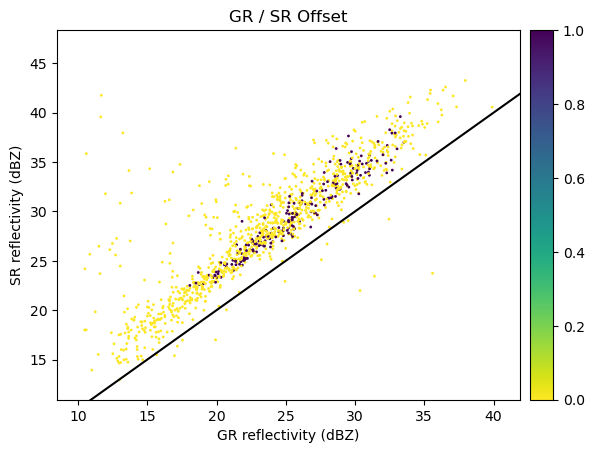

In [24]:
# Dsplay final filtering mask
gdf_match["filtering_mask"] = mask_final
reflectivity_scatterplots(
    df=gdf_match,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    hue_columns="filtering_mask",
    marker="o",
    s=1,
    cmap="viridis_r",
)

## Analyze filtered SR/GR database

We now filter the SR/GR Database, compare the reflectivity fields and display the new calibration summary:

In [25]:
gdf_final = gdf_match[mask_final]

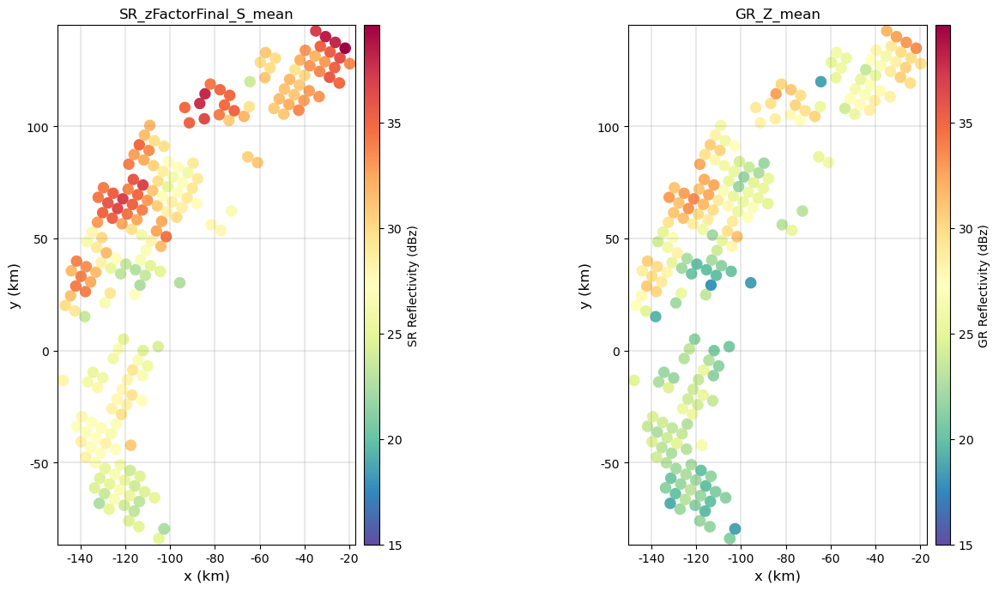

In [26]:
fig = compare_maps(
    gdf_final,
    sr_column=sr_z_column,
    gr_column=gr_z_column,
    sr_label="SR Reflectivity (dBz)",
    gr_label="GR Reflectivity (dBz)",
    cmap="Spectral_r",
    unified_color_scale=True,
    vmin=15,
    # vmax=40
)
fig.tight_layout()

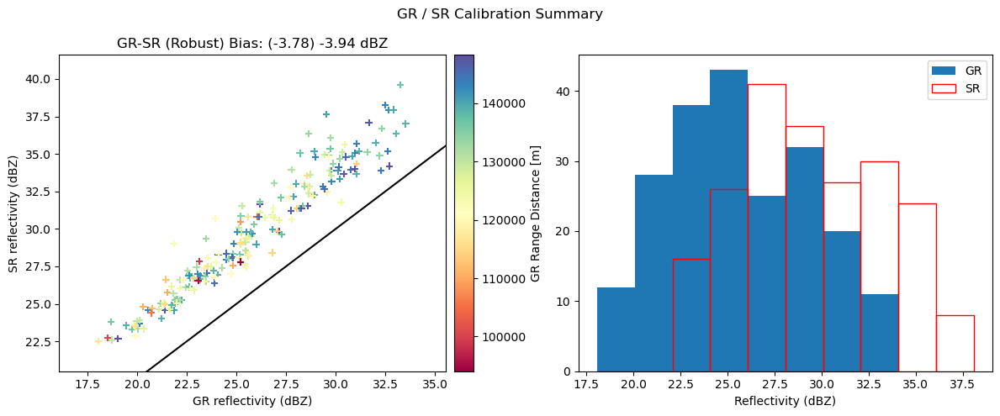

In [27]:
fig = calibration_summary(
    df=gdf_final,
    sr_z_column=sr_z_column,
    gr_z_column=gr_z_column,
    # Histogram options
    bin_width=2,
    # Scatterplot options
    # hue_column="GR_gate_volume_sum",
    hue_column="GR_range_mean",
    # gr_range=[15, 50]
    # sr_range=[15, 50]
    marker="+",
    cmap="Spectral",
)
fig.tight_layout()

Exploratory data analysis can again be performed to check if the filtering criteria were effective to discard the undesired SR/GR matched volumes and if the filtering criteria should be further expanded.

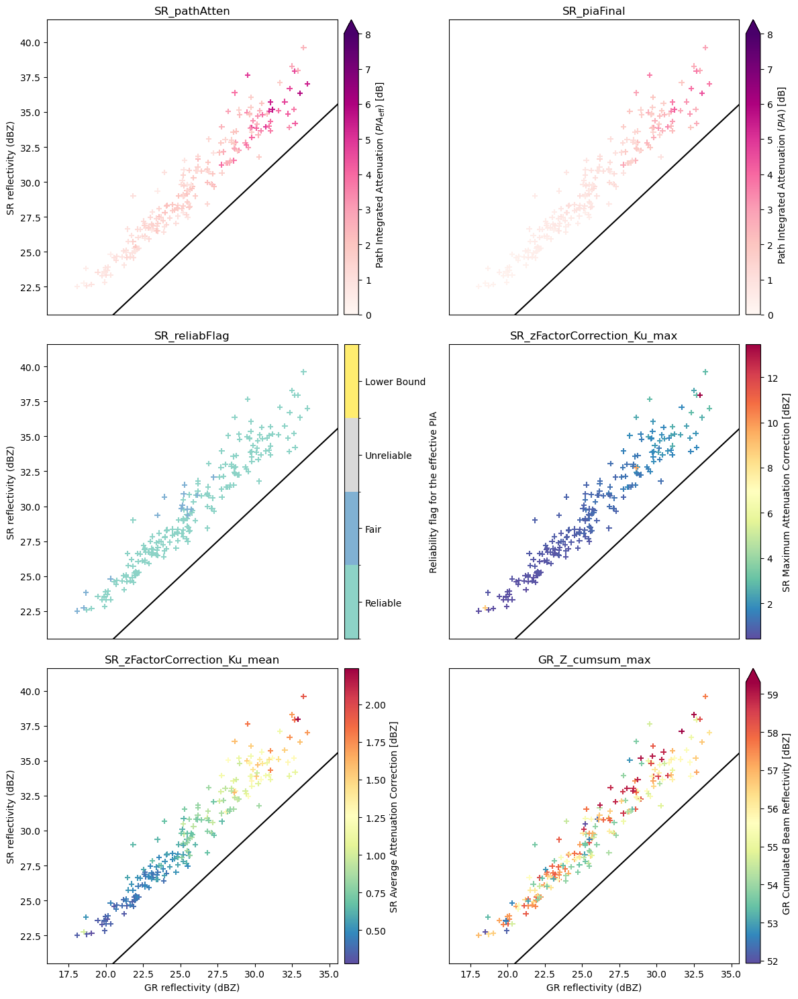

In [28]:
# Attenuation
hue_columns = [
    "SR_pathAtten",
    "SR_piaFinal",
    "SR_reliabFlag",
    "SR_zFactorCorrection_Ku_max",
    "SR_zFactorCorrection_Ku_mean",
    "GR_Z_cumsum_max",
]
fig = reflectivity_scatterplots(
    df=gdf_final,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    hue_columns=hue_columns,
    ncols=2,
)
fig.tight_layout()

## Determine GR calibration bias

The GR calibration bias can be obtained by averaging the difference between the matched SR/GR reflectivity measurements:

In [29]:
# Compute average offset
z_offset = np.nanmean(gdf_final[sr_z_column] - gdf_final[gr_z_column]).round(2)
z_offset_robust = np.nanmedian(gdf_final[sr_z_column] - gdf_final[gr_z_column]).round(2)

print(f"Th ZH Calibration offset is (mean): {z_offset} dBZ")
print(f"Th ZH Calibration offset is (median): {z_offset_robust} dBZ")

Th ZH Calibration offset is (mean): 3.94 dBZ
Th ZH Calibration offset is (median): 3.78 dBZ


## Volume matching with calibrated GR

Now, we remove the estimated GR calibration bias, we rerun the SR/GR volume matching procedure, we compare the matched reflectivities and we assess if we have effectively removed the bias by generating the calibration summary. Please note that here below we don't filter out  undesired SR/GR volumes, but this is operation is recommended once you defined appropriate robust filtering criteria !

In [30]:
# Apply offset
ds_gr["DBZH_c"] = ds_gr["DBZH"] + z_offset

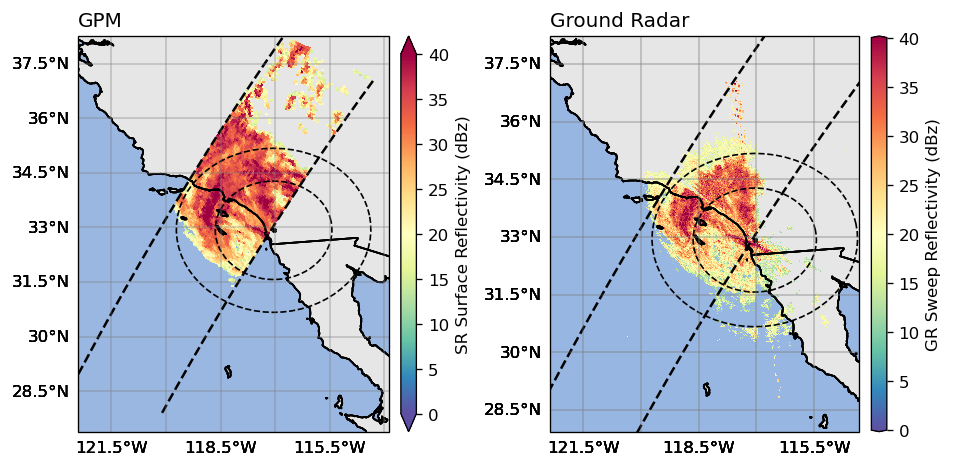

SR/GR Matching Elapsed time: 0:00:17.069898 .


In [31]:
# Apply matching
gdf_match_corrected = volume_matching(
    ds_gr=ds_gr,
    ds_sr=ds_sr,
    z_variable_gr="DBZH_c",
    radar_band=radar_band,
    beamwidth_gr=beamwidth_gr,
    z_min_threshold_gr=z_min_threshold_gr,
    z_min_threshold_sr=z_min_threshold_sr,
    min_gr_range=0,
    max_gr_range=150_000,
    # gr_sensitivity_thresholds=None,
    # sr_sensitivity_thresholds=None,
    download_sr=False,  # require internet connection !
)

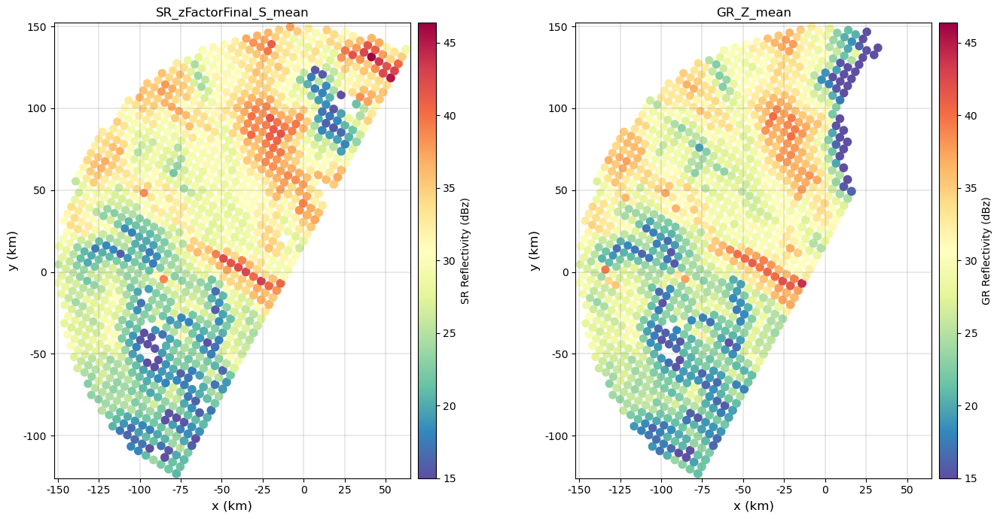

In [32]:
# Compare reflectivities
fig = compare_maps(
    gdf_match_corrected,
    sr_column=sr_z_column,
    gr_column=gr_z_column,
    sr_label="SR Reflectivity (dBz)",
    gr_label="GR Reflectivity (dBz)",
    cmap="Spectral_r",
    unified_color_scale=True,
    vmin=15,
    # vmax=40
)
fig.tight_layout()

<Axes: >

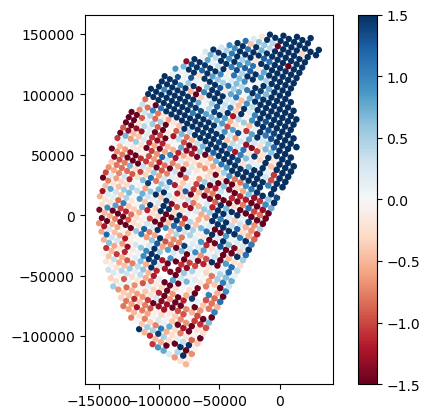

In [33]:
# Display difference in reflectivity betweeen SR and GR
gdf_match_corrected["z_offset"] = gdf_match_corrected[sr_z_column] - gdf_match_corrected[gr_z_column]
gdf_match_corrected.plot(column="z_offset", legend=True, cmap="RdBu", vmin=-1.5, vmax=1.5)

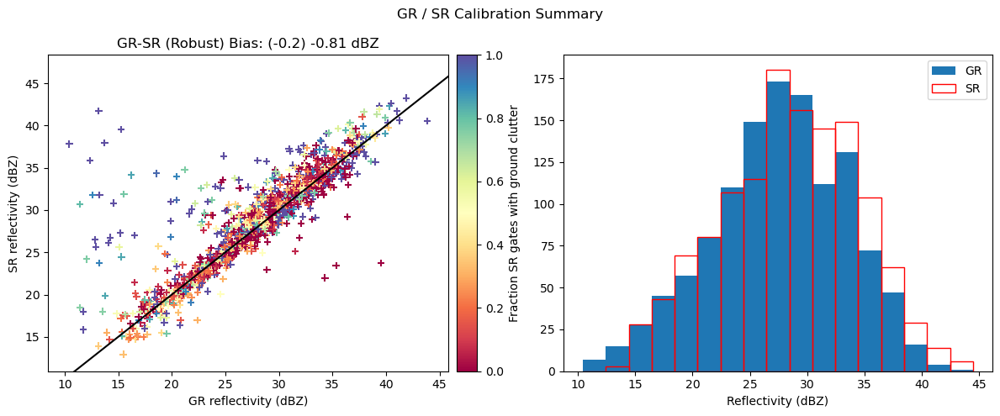

In [34]:
# Display calibration summary
fig = calibration_summary(
    df=gdf_match_corrected,
    gr_z_column=gr_z_column,
    sr_z_column=sr_z_column,
    # Histogram options
    bin_width=2,
    # Scatterplot options
    hue_column="SR_fraction_clutter",
    marker="+",
    cmap="Spectral",
)
fig.tight_layout()

## Next steps

We encourage you to explore and adapt the code provided in this tutorial to infer calibration bias also 
for the vertically polarized channel, iterate over GR sweeps, analyze multiple GPM overpasses, and assess the
long-term calibration bias of your GR network.

Please share any insights or suggestions for improving the matching procedure or filtering criteria with
the GPM-API community so we can collaboratively enhance the routines.

We hope you enjoyed the tutorial! 😊


## References

- [Cao, Q., Y. Hong, Y. Qi, Y. Wen, J. Zhang, J. J. Gourley, and L. Liao, 2013: Empirical conversion of the vertical profile of reflectivity from Ku-band to S-band frequency. J. Geophys. Res. Atmos., 118, 1814–1825, https://doi.org/10.1002/jgrd.50138](https://doi.org/10.1002/jgrd.50138)
- [Schwaller, MR, and Morris, KR. 2011. A ground validation network for the Global Precipitation Measurement mission. J. Atmos. Oceanic Technol., 28, 301-319.28, https://doi.org/10.1175/2010JTECHA1403.1](https://doi.org/10.1175/2010JTECHA1403.1)
- [Warren, R.A., A. Protat, S.T. Siems, H.A. Ramsay, V. Louf, M.J. Manton, and T.A. Kane, 2018. Calibrating ground-based radars against TRMM and GPM. J. Atmos. Oceanic Technol., 35, 323–346, https://doi.org/10.1175/JTECH-D-17-0128.1](https://doi.org/10.1175/JTECH-D-17-0128.1)

## Citation

This notebook is part of the [GPM-API  documentation](https://gpm-api.readthedocs.io/).

Large portions of this tutorials were adapted and derived from an old $\omega radlib$  tutorial.

Copyright: $\omega radlib$  and GPM-API developers.
Distributed under the MIT License. See [GPM-API license](https://github.com/ghiggi/gpm_api/blob/main/LICENSE) for more info.